Student Name: David Arturo Martinez Muraira

Student Number: 25202624

# TASK 1


Network Construction
- Download the dataset from the link below. This ZIP archive contains the raw
Wikipedia data in JSON format:
http://mlg.ucd.ie/modules/COMP30850/wiki.zip
- From the raw JSON data, construct an appropriate Wikipedia link network,
such that:
- Each node represents a unique Wikipedia article.
- Each edge indicates a link from one Wikipedia article to anothe

In [2]:
import networkx as nx
import matplotlib.pyplot as plt
import json
file= open("wiki.json","r")
data=json.load(file)
file.close()


In [ ]:
g=nx.Graph()
name_map = {}
#Iterate over the 'data', which contains character information with articles and links
for char in data:
    g.add_node(char["article"]) #Add the article (node) from the character data to the graph
    for edge in char["links"]: #Iterate over the 'links' in the character data to create edges between articles
        if g.has_edge(char["article"],edge)== False:  #If the edge does not exist, add it to the graph
            g.add_edge(char["article"],edge)

In [4]:
plt.figure(figsize=(120, 100))
nx.draw_networkx(g, with_labels=True, node_size=100, node_color="lightblue")
plt.axis("off")
plt.show()

# TASK 2

- Apply a range of different methods to characterise the structure and
connectivity of the link network created in Task 1.

- Apply several different centrality measures to identify important nodes in the
network. Discuss how the centrality scores might be interpreted in each
case.

In [5]:
print("Network Characterization")
print("Density of network: ",nx.density(g))
print("Number of nodes in the network: ",nx.number_of_nodes(g))
print("Number of edges in the network: ",nx.number_of_edges(g))
print("All nodes are connected: ",nx.is_connected(g))
print("Diameter of the network: ",nx.diameter(g))
print("Number of connected components: ",nx.number_connected_components(g))


print("\nTop 10 nodes by Betweenness Centrality:")
nodes=nx.betweenness_centrality(g)
sorted_nodes = sorted(nodes.items(), key=lambda x: x[1], reverse=True)
for node, centrality in sorted_nodes[:10]:
    print(f"Node: {node}, Betweenness Centrality: {centrality}")


degree_centrality = nx.degree_centrality(g)
sorted_degree = sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)
print("\nTop 10 nodes by Degree Centrality:")
for node, centrality in sorted_degree[:10]:
    print(f"Node: {node}, Degree Centrality: {centrality}")



closeness_centrality = nx.closeness_centrality(g)
sorted_closeness = sorted(closeness_centrality.items(), key=lambda x: x[1], reverse=True)
print("\nTop 10 nodes by Closeness Centrality:")
for node, centrality in sorted_closeness[:10]:
    print(f"Node: {node}, Closeness Centrality: {centrality}")

print("")
eigenvector_centrality = nx.eigenvector_centrality(g, max_iter=1000)
sorted_eigenvector = sorted(eigenvector_centrality.items(), key=lambda x: x[1], reverse=True)
print("\nTop 10 nodes by Eigenvector Centrality:")
for node, centrality in sorted_eigenvector[:10]:
    print(f"Node: {node}, Eigenvector Centrality: {centrality}")

Network Characterization
Density of network:  0.034143757614280415
Number of nodes in the network:  435
Number of edges in the network:  3223
All nodes are connected:  True
Diameter of the network:  4
Number of connected components:  1

Top 10 nodes by Betweenness Centrality:
Node: Republic of Ireland, Betweenness Centrality: 0.09181279781263957
Node: World War II, Betweenness Centrality: 0.09106433263257938
Node: Joe Biden, Betweenness Centrality: 0.07434915048788983
Node: Bill Clinton, Betweenness Centrality: 0.06084285606269822
Node: Leinster Rugby, Betweenness Centrality: 0.05563315655401505
Node: Barack Obama, Betweenness Centrality: 0.05002540957143355
Node: Rugby union, Betweenness Centrality: 0.044269441854853604
Node: Hurling, Betweenness Centrality: 0.04344352018226248
Node: Ronald Reagan, Betweenness Centrality: 0.04141115044473754
Node: Northern Ireland, Betweenness Centrality: 0.03823767780604833

Top 10 nodes by Degree Centrality:
Node: Joe Biden, Degree Centrality: 0.223

# Overview

By analyzing different network characterizations, we can observe several key aspects of our network. The network consists of 435 nodes and 3223 edges, with a low density, indicating that it is more sparse than dense.

All nodes are connected, meaning that every article can be reached from any other article by following the links. This is further confirmed by the single connected component and the network's diameter of 4, which implies that any article can be reached within at most four steps.

# TASK 3

• Apply a community detection algorithm in Python to the Wikipedia link
network to identify clusters of related articles. Analyse the results by briefly
describing the thematic focus of each detected community.

• Choose one representative node from each identified community and create
its ego network. Characterise each ego network by calculating its size,
density, and degree distribution. Visualise each ego network in your
notebook.

In [6]:
communities = nx.community.louvain_communities(g)


Detected Communities:
Community 0: ['Nancy Reagan', 'Drug Enforcement Administration', 'Ulysses S. Grant', 'Abraham Lincoln', 'President of the United States', 'United States Department of Justice', 'Georgia (U.S. state)', 'Maya Angelou', 'William E. Niblack', 'Frank E. McKinney', 'John Hickenlooper', 'Sonia Sotomayor', 'Eric Chester', 'Council of Economic Advisers', 'United States Department of State', 'Jim Gilmore', 'United States Armed Forces', 'Chester A. Arthur', 'Gerald Ford', 'Lisa Murkowski', 'Capital punishment in the United States', 'Watergate scandal', 'George H. W. Bush', 'Ronald Reagan', 'FBI', 'Harry S. Truman', 'Federal government of the United States', 'Michelle Obama', 'Woodrow Wilson', 'Al Gore', 'Mike Huckabee', 'Walter Mondale', 'Theodore Roosevelt', 'Ron Paul', 'Second-wave feminism', 'Classes of United States senators', 'Marco Rubio', 'Christian right', 'Ralph Nader', 'Illegal immigration to the United States', 'Saddam Hussein', 'Mitch McConnell', 'Congressional 

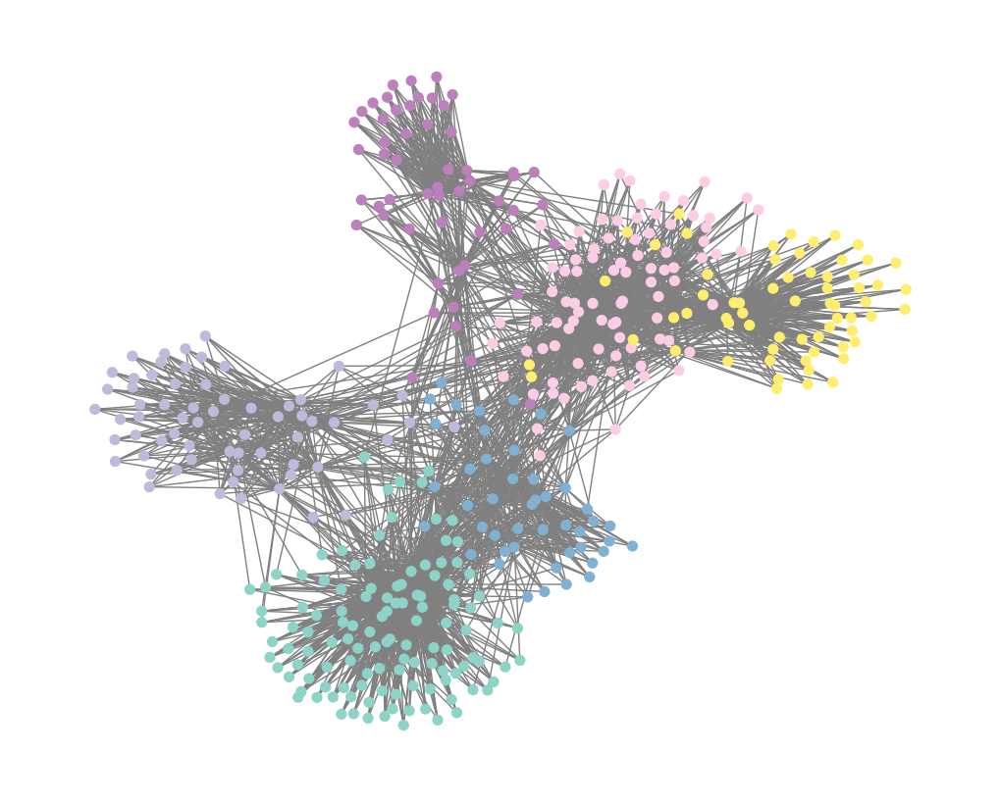

In [7]:
print("\nDetected Communities:")
for i, community in enumerate(communities):
    print(f"Community {i}: {list(community)}")

# Function to draw the network with community colors
def draw_communities(g, communities):
    # Map nodes to community IDs
    community_map = {}
    for i, community in enumerate(communities):
        for node in community:
            community_map[node] = i
    
    # Get a colormap from matplotlib
    pal = plt.get_cmap("Set3")  # Use a distinct color palette

    # Assign colors to nodes based on their community
    community_colors = [community_map[node] for node in g.nodes()]

    # Draw the network
    plt.figure(figsize=(10, 8))
    pos = nx.spring_layout(g)
    nx.draw(g, pos, with_labels=False, node_color=community_colors, cmap=pal, edge_color='gray', 
            node_size=50, font_size=8)
    
    plt.axis('off')
    plt.show()

# Draw graph with community colors and legend
draw_communities(g, communities)


By analyzing the network structure, we identified six distinct communities and we can also see these 6 clusters inside our plot, each centered around specific topics. A closer examination reveals that nodes within each community share thematic connections:

1. Infectious diseases, epidemiology, public health, virology, immunization, pandemics, disease control, and global health organizations.

2. U.S. politics, government institutions, political leaders, the judicial system, military, historical events, social movements, and policy issues.

3. World War I, World War II, military history, geopolitical alliances, and 20th-century political leaders.

4. Ireland, Irish history, politics, sports, geography, language, and culture.

5. Football, football clubs, national teams, tournaments, and international organizations.

6. Rugby union, clubs, teams, competitions, stadiums, and governing bodies.

To determine the most representative nodes from each community, we will identify the most influential nodes based on centrality measures.

In [ ]:
#Initialize an empty dictionary to store the most influential nodes for each community
most_influential_nodes = {}
#Iterate over the communities, where 'i' is the index and 'community' is the set of nodes
for i, community in enumerate(communities):
     community_nodes = list(community) #Convert the community set to a list of nodes
     influential_node_degree = max(community_nodes, key=lambda node: degree_centrality[node]) # Find the node with the highest degree centrality within the community
     ego_network = nx.ego_graph(g, influential_node_degree) #Create an ego network for the most influential node (subgraph containing the node and its neighbors)
     #Store the most influential node's degree in the dictionary, using the community index as the key
     most_influential_nodes[i] = { 
        'degree': influential_node_degree,
    }
print(most_influential_nodes)

{0: {'degree': 'Joe Biden'}, 1: {'degree': 'World Health Organization'}, 2: {'degree': 'World War II'}, 3: {'degree': 'Republic of Ireland'}, 4: {'degree': 'UEFA'}, 5: {'degree': 'Leinster Rugby'}}


Having identified the most influential nodes from each community which are Joe Biden, World Health Organization, World War II, Republic f Ireland, UEFA and Leinster Rugby we now proceed to create our ego networks centered around these nodes. 

Network Characterization
Density of network:  0.2247918593894542
Number of nodes in the network:  47
Number of edges in the network:  243
All nodes are connected:  True
Diameter of the network:  2
Number of connected components:  1


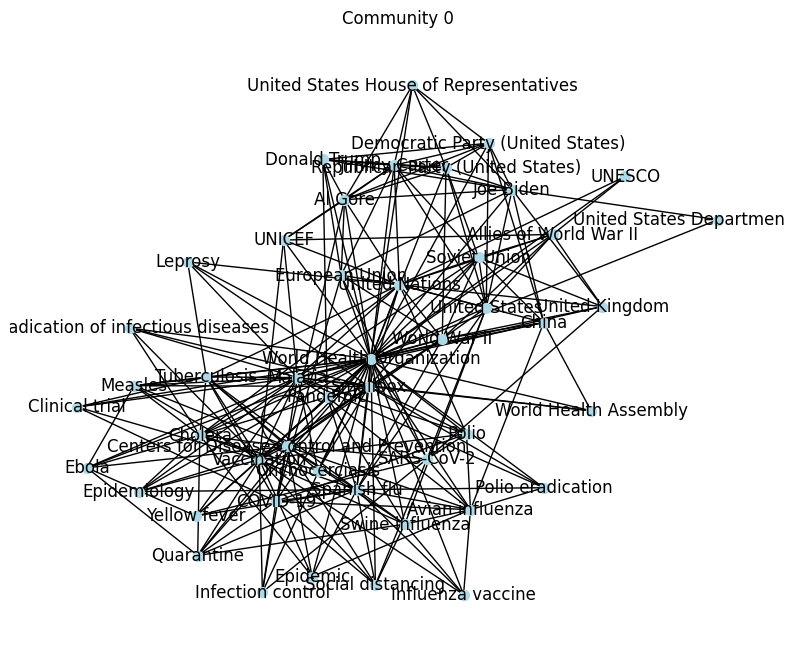

In [9]:
cm0=nx.ego_graph(g,"World Health Organization")
print("Network Characterization")
print("Density of network: ",nx.density(cm0))
print("Number of nodes in the network: ",nx.number_of_nodes(cm0))
print("Number of edges in the network: ",nx.number_of_edges(cm0))
print("All nodes are connected: ",nx.is_connected(cm0))
print("Diameter of the network: ",nx.diameter(cm0))
print("Number of connected components: ",nx.number_connected_components(cm0))
plt.figure(figsize=(10, 8))
nx.draw_networkx(cm0, with_labels=True, node_size=50, node_color="lightblue")
plt.axis("off")
plt.title("Community 0")
plt.show()

Network Characterization
Density of network:  0.14622343782873976
Number of nodes in the network:  98
Number of edges in the network:  695
All nodes are connected:  True
Diameter of the network:  2
Number of connected components:  1


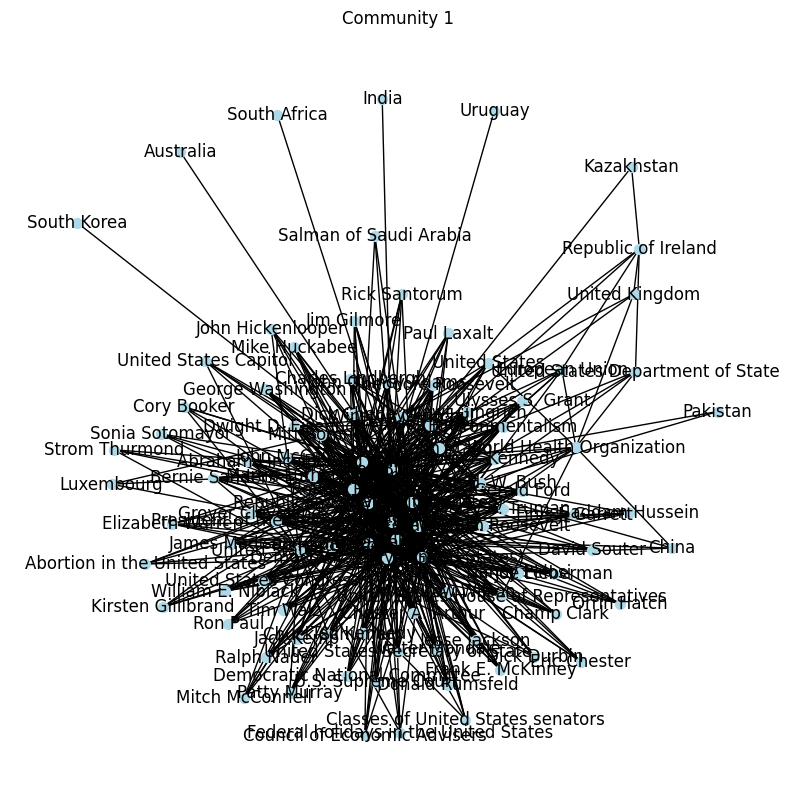

In [10]:
cm1=nx.ego_graph(g,"Joe Biden")
print("Network Characterization")
print("Density of network: ",nx.density(cm1))
print("Number of nodes in the network: ",nx.number_of_nodes(cm1))
print("Number of edges in the network: ",nx.number_of_edges(cm1))
print("All nodes are connected: ",nx.is_connected(cm1))
print("Diameter of the network: ",nx.diameter(cm1))
print("Number of connected components: ",nx.number_connected_components(cm1))
plt.figure(figsize=(10, 10))
nx.draw_networkx(cm1, with_labels=True, node_size=50, node_color="lightblue")
plt.axis("off")
plt.title("Community 1")
plt.show()

Network Characterization
Density of network:  0.21212121212121213
Number of nodes in the network:  66
Number of edges in the network:  455
All nodes are connected:  True
Diameter of the network:  2
Number of connected components:  1


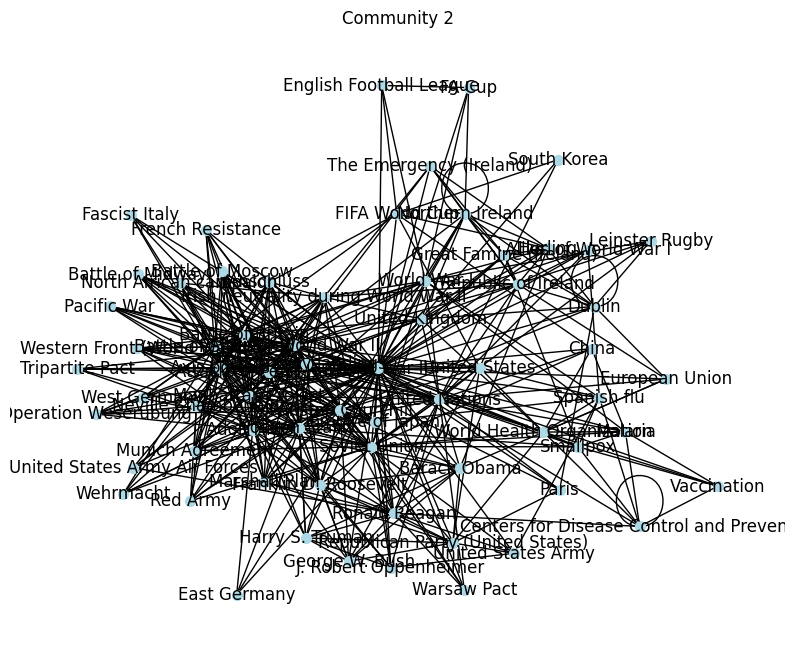

In [11]:
cm2=nx.ego_graph(g,"World War II")
print("Network Characterization")
print("Density of network: ",nx.density(cm2))
print("Number of nodes in the network: ",nx.number_of_nodes(cm2))
print("Number of edges in the network: ",nx.number_of_edges(cm2))
print("All nodes are connected: ",nx.is_connected(cm2))
print("Diameter of the network: ",nx.diameter(cm2))
print("Number of connected components: ",nx.number_connected_components(cm2))
plt.figure(figsize=(10, 8))
nx.draw_networkx(cm2, with_labels=True, node_size=50, node_color="lightblue")
plt.axis("off")
plt.title("Community 2")
plt.show()

Network Characterization
Density of network:  0.15579958819492107
Number of nodes in the network:  94
Number of edges in the network:  681
All nodes are connected:  True
Diameter of the network:  2
Number of connected components:  1


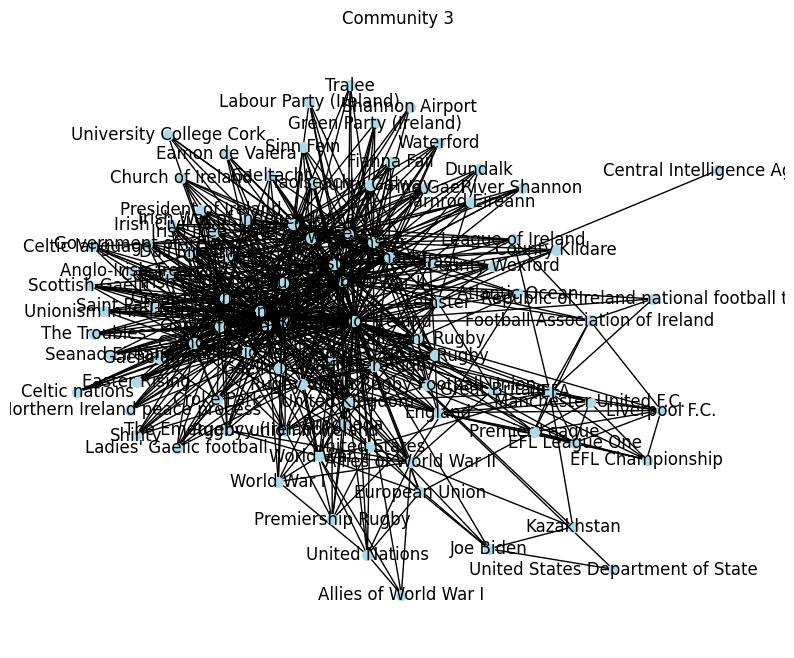

In [12]:
cm3=nx.ego_graph(g,"Republic of Ireland")
print("Network Characterization")
print("Density of network: ",nx.density(cm3))
print("Number of nodes in the network: ",nx.number_of_nodes(cm3))
print("Number of edges in the network: ",nx.number_of_edges(cm3))
print("All nodes are connected: ",nx.is_connected(cm3))
print("Diameter of the network: ",nx.diameter(cm3))
print("Number of connected components: ",nx.number_connected_components(cm3))
plt.figure(figsize=(10, 8))
nx.draw_networkx(cm3, with_labels=True, node_size=50, node_color="lightblue")
plt.axis("off")
plt.title("Community 3")
plt.show()

Network Characterization
Density of network:  0.17722473604826547
Number of nodes in the network:  52
Number of edges in the network:  235
All nodes are connected:  True
Diameter of the network:  2
Number of connected components:  1


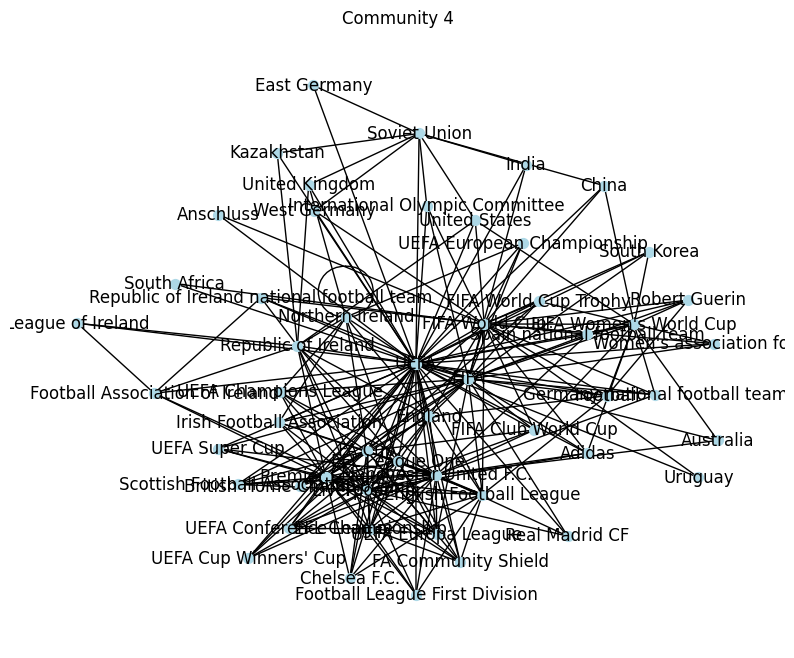

In [13]:
cm4=nx.ego_graph(g,"UEFA")
print("Network Characterization")
print("Density of network: ",nx.density(cm4))
print("Number of nodes in the network: ",nx.number_of_nodes(cm4))
print("Number of edges in the network: ",nx.number_of_edges(cm4))
print("All nodes are connected: ",nx.is_connected(cm4))
print("Diameter of the network: ",nx.diameter(cm4))
print("Number of connected components: ",nx.number_connected_components(cm4))
plt.figure(figsize=(10, 8))
nx.draw_networkx(cm4, with_labels=True, node_size=50, node_color="lightblue")
plt.axis("off")
plt.title("Community 4")
plt.show()

Network Characterization
Density of network:  0.15211267605633802
Number of nodes in the network:  71
Number of edges in the network:  378
All nodes are connected:  True
Diameter of the network:  2
Number of connected components:  1


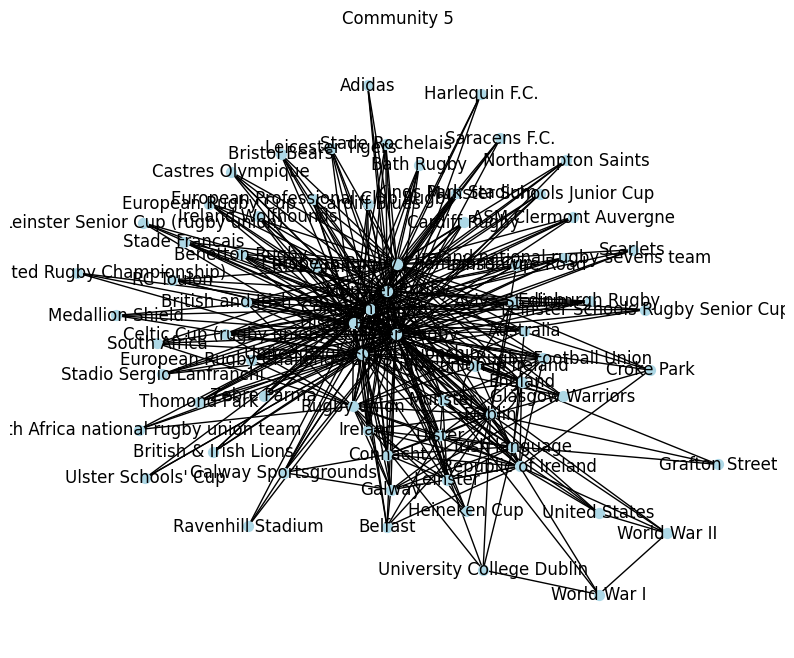

In [14]:
cm5=nx.ego_graph(g,"Leinster Rugby")
print("Network Characterization")
print("Density of network: ",nx.density(cm5))
print("Number of nodes in the network: ",nx.number_of_nodes(cm5))
print("Number of edges in the network: ",nx.number_of_edges(cm5))
print("All nodes are connected: ",nx.is_connected(cm5))
print("Diameter of the network: ",nx.diameter(cm5))
print("Number of connected components: ",nx.number_connected_components(cm5))
plt.figure(figsize=(10, 8))
nx.draw_networkx(cm5, with_labels=True, node_size=50, node_color="lightblue")
plt.axis("off")
plt.title("Community 5")
plt.show()

In [15]:
node_community = {}

for i, community in enumerate(communities):
    for node in community:
        node_community[node] = i  


nx.set_node_attributes(g, node_community, "community")
print(nx.get_node_attributes(g, "community"))

{'World Health Organization': 1, 'Al Gore': 0, 'Centers for Disease Control and Prevention': 1, 'China': 1, 'Cholera': 1, 'Clinical trial': 1, 'Democratic Party (United States)': 0, 'Donald Trump': 0, 'Ebola': 1, 'Epidemic': 1, 'Epidemiology': 1, 'Eradication of infectious diseases': 1, 'European Union': 1, 'Infection control': 1, 'Influenza vaccine': 1, 'Joe Biden': 0, 'Leprosy': 1, 'Malaria': 1, 'Measles': 1, 'Onchocerciasis': 1, 'Pandemic': 1, 'Polio': 1, 'Polio eradication': 1, 'Quarantine': 1, 'Republican Party (United States)': 0, 'Smallpox': 1, 'Social distancing': 1, 'Soviet Union': 2, 'Tuberculosis': 1, 'UNESCO': 3, 'UNICEF': 1, 'United Kingdom': 2, 'United Nations': 2, 'United States': 2, 'United States Department of State': 0, 'United States House of Representatives': 0, 'Vaccination': 1, 'World Health Assembly': 1, 'World War II': 2, 'Yellow fever': 1, 'Barack Obama': 0, 'Bill Clinton': 0, 'Champ Clark': 0, 'Chester A. Arthur': 0, 'Christian right': 0, 'Chuck Schumer': 0, '

In [16]:
nx.write_gexf(g, "ego.gexf")